Completed by Prateek Garg (20D070060) alone.

## **Problem 1:**

#### Study the challenge statement of MoNuSeg challenge,read the data and display a few training and testing images and their masks (black background, and a random color for each cell nucleus).

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Image, display
from PIL import ImageOps

from google.colab.patches import cv2_imshow
import os
import glob

from google.colab import drive
drive.mount('/content/drive')

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# to show multiple images in a crisp way
def imshow3(imarray):
  cv2_imshow(np. concatenate(imarray, axis=1))

In [ ]:
train_path = "/content/drive/MyDrive/MoNuSeg-Training-Data"

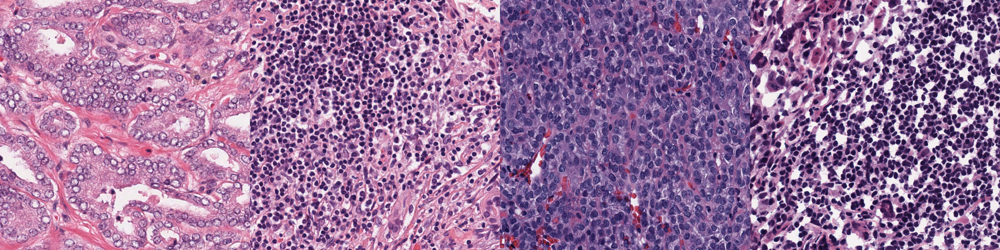

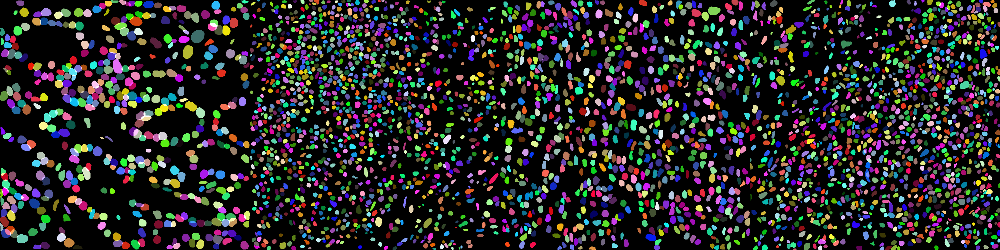

In [ ]:
np.random.seed(25) # Setting the seed to get same results everytime we execute
imarr = list(np.random.choice(os.listdir(os.path.join(train_path,"Tissue-Images")),4, replace=False))

imgs = []
masks = []

for x in imarr:
  imgs.append(cv2.imread(os.path.join(train_path, os.path.join("Tissue-Images",x))))
  masks.append(cv2.imread(os.path.join(train_path, os.path.join("Color-Mask",x))))

imshow3(imgs)
imshow3(masks)

In [ ]:
test_path = "/content/drive/MyDrive/MoNuSeg-Test-Data"

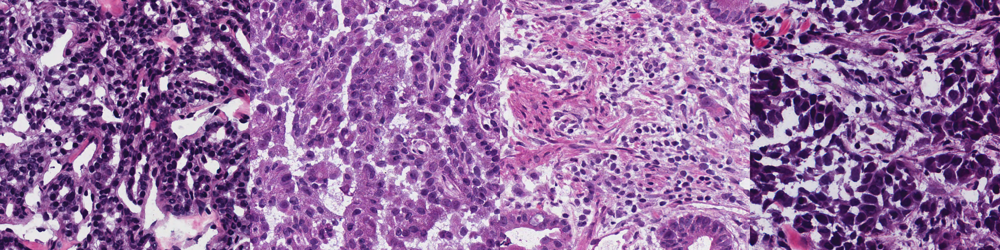

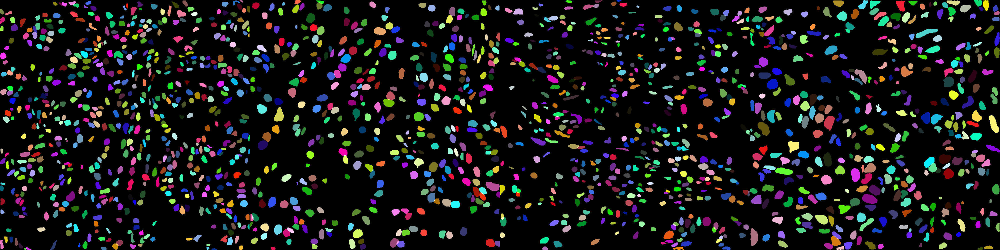

In [ ]:
np.random.seed(25)
imarr = list(np.random.choice(os.listdir(os.path.join(test_path,"Tissue-Images")),4, replace=False))
# ['TCGA-49-4488-01Z-00-DX1.png','TCGA-G2-A2EK-01A-02-TSB.png','TCGA-E2-A1B5-01Z-00-DX1.png','TCGA-G9-6362-01Z-00-DX1.png']

imgs = []
masks = []

for x in imarr:
  imgs.append(cv2.imread(os.path.join(test_path, os.path.join("Tissue-Images",x))))
  masks.append(cv2.imread(os.path.join(test_path, os.path.join("Color-Mask",x))))

imshow3(imgs)
imshow3(masks)

## **Problem 2:**

#### Code a basic UNet for semantic segmentation in TF + Keras or Pytorch for the binary nucleus vs. non-nucleus segmentation .

In [ ]:
import tensorflow as tf

from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.models import Model, load_model
from tensorflow.keras import layers
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras import backend as K
from keras.utils.vis_utils import plot_model

In [ ]:
# creating a down block which will be used in U-net, when called returns skip connection and output after pooling
class down_block(Model):
    def __init__(self,num_filters=32,**kwargs):
        super(down_block, self).__init__()
        self.num_filters = num_filters
        self.conv_layer1 = layers.Conv2D(self.num_filters, (3, 3), activation='relu', padding='same')
        self.conv_layer2 = layers.Conv2D(self.num_filters, (3, 3), activation='relu', padding='same')
        self.pool_layer  = layers.MaxPooling2D((2, 2))
        super(down_block, self).__init__(**kwargs)

    def call(self, inputs):
      c1 = self.conv_layer1(inputs)
      c1 = self.conv_layer2(c1)
      p1 = self.pool_layer(c1)
      return p1,c1

# creating a up block which will be used in U-net, accepts a skip connection and input.
class up_block(Model):
    def __init__(self,num_filters=32,**kwargs):
        super(up_block, self).__init__()
        self.num_filters = num_filters
        self.u_conv  = layers.Conv2DTranspose(self.num_filters, (2, 2), strides=(2, 2), padding='same')
        self.concat  = layers.concatenate
        self.d_conv1 = layers.Conv2D(self.num_filters, (3, 3), activation='relu', padding='same')
        self.d_conv2 = layers.Conv2D(self.num_filters, (3, 3), activation='relu', padding='same')
        super(up_block, self).__init__(**kwargs)

    def call(self, inputs):
      u6 = self.u_conv(inputs[0])
      u6 = self.concat([u6, inputs[1]])
      c6 = self.d_conv1(u6)
      c6 = self.d_conv2(c6)
      return c6


def u_net(init_filters = 32,num_blocks = 4,im_size = (128,128,3)):
  """
    returns Keras based U-Net model.

    init_filters : No. of filters in first layer
    num_blocks: "depth" of the network, number of blocks to convolve down to before going up.
    im_size: size of input image

  """
  nfilters = init_filters

  skip_conn = [] # List to store reference for later use

  inputs = layers.Input(im_size) # placeholder for  input image
  s = layers.Lambda(lambda x: x / 255) (inputs) # normalization

  # creates the downward path, appends skip references to skip_conn
  # number of filters doubles as we go down
  for i in range(num_blocks):
    s,f = down_block(nfilters)(s)
    skip_conn.append(f)
    nfilters = 2*nfilters

  # Bottommost Layer
  s = layers.Conv2D(nfilters, (3, 3), activation='relu', padding='same') (s)
  s = layers.Conv2D(nfilters, (3, 3), activation='relu', padding='same') (s)

  # creates the downward path, appends skip references to skip_conn
  # number of filters are halved as we go down
  for i in range(num_blocks):
    nfilters = nfilters/2
    s = up_block(nfilters)([s,skip_conn[-1]])
    skip_conn.pop()

  outputs = layers.Conv2D(1, (1, 1), activation='sigmoid') (s)

  model = Model(inputs=[inputs], outputs=[outputs])

  return model


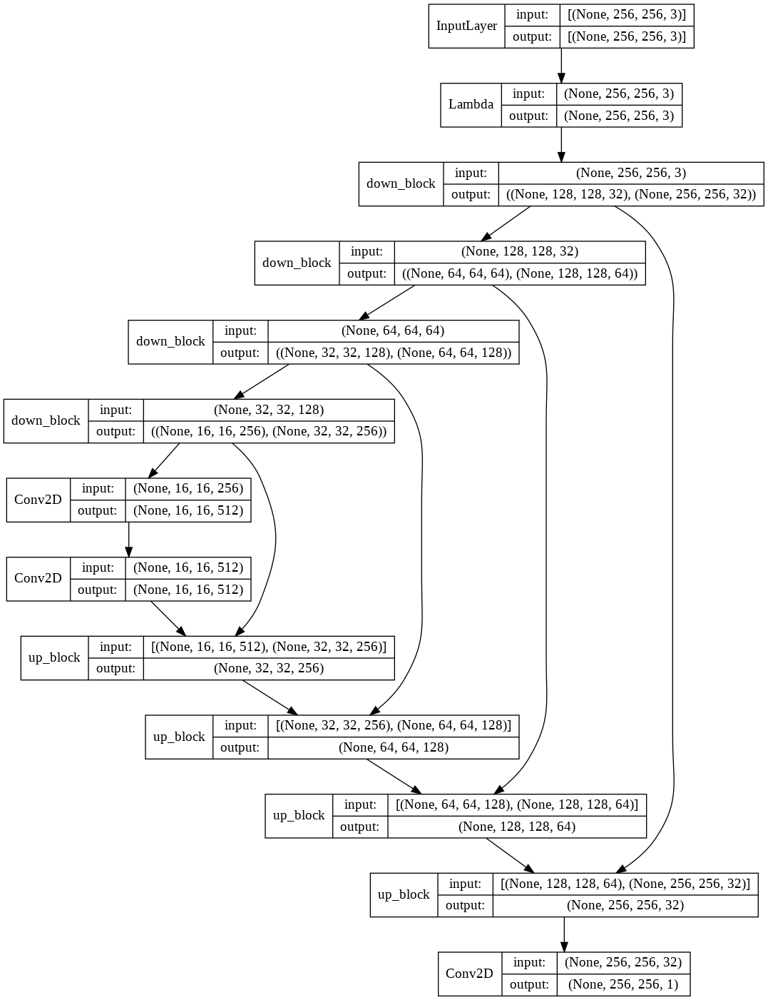

In [ ]:
# The dimensions used  by dataloader and model for input image
IMG_WIDTH, IMG_HEIGHT, IMG_CHANNELS = (256,256,3)

K.clear_session() # free up memory in case model definition is executed mutliple times
model = u_net(init_filters = 32,num_blocks = 4,im_size = (IMG_WIDTH, IMG_HEIGHT, IMG_CHANNELS))

# The dimensions used  by dataloader and model for output mask
target_size = model.output_shape[1:-1]

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=False)
# click to expand model diagram if small

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 lambda (Lambda)                (None, 256, 256, 3)  0           ['input_1[0][0]']                
                                                                                                  
 down_block_1 (down_block)      ((None, 128, 128, 3  10144       ['lambda[0][0]']                 
                                2),                                                               
                                 (None, 256, 256, 3                                           

## **Problem 3:**

#### Train the UNet using Dice loss,and show Dice score on validation and test data.

In [ ]:
# Preparing the data
input_img_paths = sorted(list(glob.glob(os.path.join(train_path+"/Tissue-Images", '*'))))
target_img_paths = sorted(list(glob.glob(os.path.join(train_path+"/Binary-Mask", '*'))))

print("Number of samples:", len(input_img_paths))
for input_path, target_path in zip(input_img_paths, target_img_paths):
    print(input_path, "|", target_path)



Number of samples: 30
/content/drive/MyDrive/MoNuSeg-Training-Data/Tissue-Images/TCGA-18-5592-01Z-00-DX1.png | /content/drive/MyDrive/MoNuSeg-Training-Data/Binary-Mask/TCGA-18-5592-01Z-00-DX1.png
/content/drive/MyDrive/MoNuSeg-Training-Data/Tissue-Images/TCGA-21-5784-01Z-00-DX1.png | /content/drive/MyDrive/MoNuSeg-Training-Data/Binary-Mask/TCGA-21-5784-01Z-00-DX1.png
/content/drive/MyDrive/MoNuSeg-Training-Data/Tissue-Images/TCGA-21-5786-01Z-00-DX1.png | /content/drive/MyDrive/MoNuSeg-Training-Data/Binary-Mask/TCGA-21-5786-01Z-00-DX1.png
/content/drive/MyDrive/MoNuSeg-Training-Data/Tissue-Images/TCGA-38-6178-01Z-00-DX1.png | /content/drive/MyDrive/MoNuSeg-Training-Data/Binary-Mask/TCGA-38-6178-01Z-00-DX1.png
/content/drive/MyDrive/MoNuSeg-Training-Data/Tissue-Images/TCGA-49-4488-01Z-00-DX1.png | /content/drive/MyDrive/MoNuSeg-Training-Data/Binary-Mask/TCGA-49-4488-01Z-00-DX1.png
/content/drive/MyDrive/MoNuSeg-Training-Data/Tissue-Images/TCGA-50-5931-01Z-00-DX1.png | /content/drive/MyDr

In [ ]:
# Create a dataloader class
class TissueSeg(keras.utils.Sequence):
    """Helper to iterate over the data (as Numpy arrays)."""

    def __init__(self, batch_size, img_size,target_size, input_img_paths, target_img_paths):
        self.batch_size = batch_size
        self.img_size = img_size
        self.input_img_paths = input_img_paths
        self.target_img_paths = target_img_paths
        self.target_size = target_size

    def __len__(self):
        return len(self.target_img_paths) // self.batch_size

    def __getitem__(self, idx):
        """Returns tuple (input, target) correspond to batch #idx."""
        i = idx * self.batch_size
        batch_input_img_paths = self.input_img_paths[i : i + self.batch_size]
        batch_target_img_paths = self.target_img_paths[i : i + self.batch_size]
        x = np.zeros((self.batch_size,) + self.img_size + (3,), dtype="float32")
        for j, path in enumerate(batch_input_img_paths):
            img = load_img(path, target_size=self.img_size)
            x[j] = img
        self.img_size = self.target_size # Model Compatibilty
        y = np.zeros((self.batch_size,) + self.target_size + (1,), dtype="float32")
        for j, path in enumerate(batch_target_img_paths):
            img = load_img(path, target_size=self.target_size, color_mode="grayscale") 
            y[j] = np.expand_dims(img, 2)/255 # Normalize Binary Mask
        return x, y


In [ ]:
import random

# Split our img paths into a training and a validation set
val_samples = 4
random.Random(1337).shuffle(input_img_paths)
random.Random(1337).shuffle(target_img_paths)
train_input_img_paths = input_img_paths[:-val_samples]
train_target_img_paths = target_img_paths[:-val_samples]
val_input_img_paths = input_img_paths[-val_samples:]
val_target_img_paths = target_img_paths[-val_samples:]

batch_size = 2
img_size   = (IMG_WIDTH,IMG_HEIGHT) 
# Instantiate data Sequences for each split
train_gen = TissueSeg(
    batch_size, img_size,target_size, train_input_img_paths, train_target_img_paths
)
val_gen = TissueSeg(batch_size, img_size,target_size, val_input_img_paths, val_target_img_paths)


In [ ]:
# defining Dice loss
def dice_coef(y_true, y_pred, smooth=1):
  intersection = K.sum(K.abs(y_true * y_pred), axis=-1)
  return (2. * intersection + smooth) / (K.sum(K.square(y_true),-1) + K.sum(K.square(y_pred),-1) + smooth)

def dice_coef_loss(y_true, y_pred):
  return 1-dice_coef(y_true, y_pred)

In [ ]:
model.compile(optimizer="adam", loss=dice_coef_loss, metrics=['accuracy',dice_coef])

callbacks = [
    keras.callbacks.ModelCheckpoint("tissue_segmentation.h5", save_best_only=True)
]

# Train the model, doing validation at the end of each epoch.
epochs = 50
history = model.fit(train_gen, epochs=epochs, validation_data=val_gen, callbacks=callbacks)
# model.save

Epoch 1/50
13/13 [==============================] - 7s 211ms/step - loss: 0.1209 - accuracy: 0.7131 - dice_coef: 0.8791 - val_loss: 0.1000 - val_accuracy: 0.7377 - val_dice_coef: 0.9000
Epoch 2/50
13/13 [==============================] - 2s 183ms/step - loss: 0.0934 - accuracy: 0.7363 - dice_coef: 0.9066 - val_loss: 0.0904 - val_accuracy: 0.7387 - val_dice_coef: 0.9096
Epoch 3/50
13/13 [==============================] - 2s 164ms/step - loss: 0.0907 - accuracy: 0.7511 - dice_coef: 0.9093 - val_loss: 0.1049 - val_accuracy: 0.7425 - val_dice_coef: 0.8951
Epoch 4/50
13/13 [==============================] - 2s 186ms/step - loss: 0.0878 - accuracy: 0.7561 - dice_coef: 0.9122 - val_loss: 0.0854 - val_accuracy: 0.7803 - val_dice_coef: 0.9146
Epoch 5/50
13/13 [==============================] - 2s 164ms/step - loss: 0.0750 - accuracy: 0.8045 - dice_coef: 0.9250 - val_loss: 0.0906 - val_accuracy: 0.7725 - val_dice_coef: 0.9094
Epoch 6/50
13/13 [==============================] - 2s 164ms/step - lo

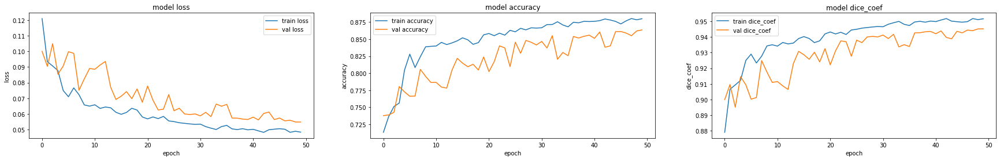

In [ ]:
metrics = model.metrics_names
fig, axs = plt.subplots(figsize=(30,4),nrows=1, ncols=len(metrics))

for i,met in enumerate(metrics):
  axs[i].plot(history.history[met])
  axs[i].plot(history.history['val_'+met])
  axs[i].set_title('model {}'.format(met))
  axs[i].set_ylabel(met)
  axs[i].set_xlabel('epoch')
  axs[i].legend(['train '+met, 'val '+met])

plt.show()


## **Problem 4:**

#### Show a few output maps.

In [ ]:
def dmask(y):
  mask = ((y>0.5).astype(int))*255
  img = ImageOps.autocontrast(keras.preprocessing.image.array_to_img(mask))
  return img.convert('RGB')

2/2 [==============================] - 1s 130ms/step


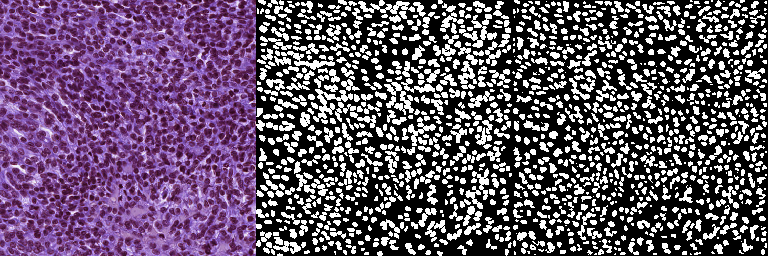

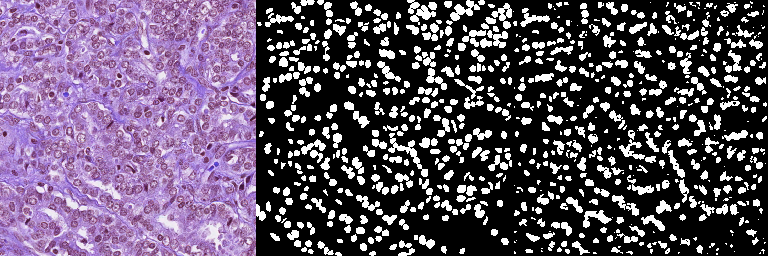

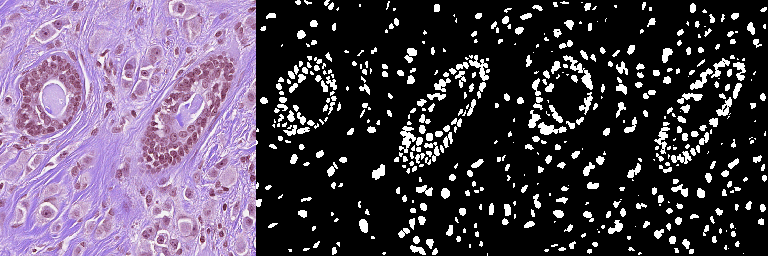

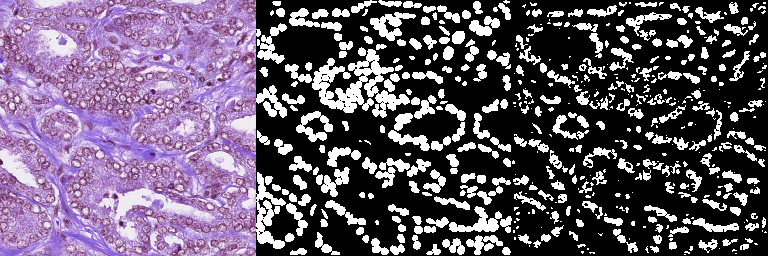

In [ ]:
# Generate predictions for all images in the validation set
val_preds = model.predict(val_gen)

for i in range(val_samples):
  imshow3([load_img(val_input_img_paths[i], target_size=target_size),ImageOps.autocontrast(load_img(val_target_img_paths[i],target_size=target_size)),dmask(val_preds[i])])

# Input, Ground Truth, Output

## **Problem 5:**

#### Modify this baseline architecture to study the impact of changing.

a. Number of blocks in the UNet architecture.

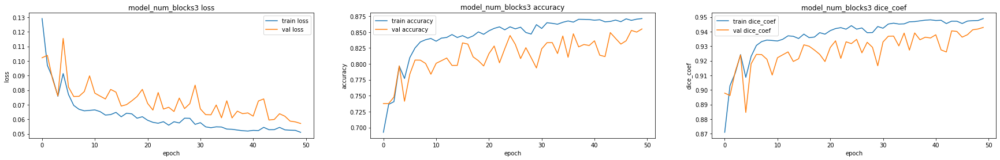

2/2 [==============================] - 0s 124ms/step


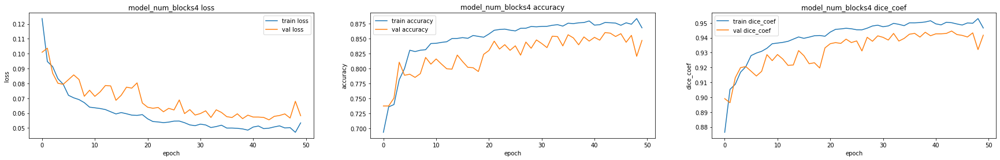

2/2 [==============================] - 1s 133ms/step


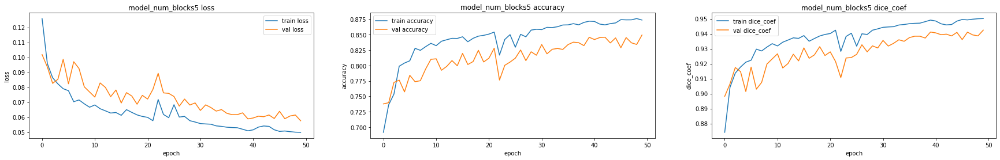

2/2 [==============================] - 1s 136ms/step


In [ ]:
num_blocks_arr = [3,4,5]

pred_masks = []
for num_blocks in num_blocks_arr:
  model = u_net(init_filters = 32,num_blocks = num_blocks,im_size = (IMG_WIDTH, IMG_HEIGHT, IMG_CHANNELS))

  model.compile(optimizer="adam", loss=dice_coef_loss, metrics=['accuracy',dice_coef])

  callbacks = [
      keras.callbacks.ModelCheckpoint("tissue_segmentation_num_blocks_{}.h5".format(num_blocks), save_best_only=True)
  ]

  epochs = 50 
  history = model.fit(train_gen, epochs=epochs, validation_data=val_gen, callbacks=callbacks,verbose=0 )

  metrics = model.metrics_names
  fig, axs = plt.subplots(figsize=(30,4),nrows=1, ncols=len(metrics))

  for i,met in enumerate(metrics):
    axs[i].plot(history.history[met])
    axs[i].plot(history.history['val_'+met])
    axs[i].set_title('model_num_blocks{} {}'.format(num_blocks,met))
    axs[i].set_ylabel(met)
    axs[i].set_xlabel('epoch')
    axs[i].legend(['train '+met, 'val '+met])

  plt.show()

  # Generate predictions for all images in the validation set
  val_preds = model.predict(val_gen)
  pred_masks.append(val_preds)
 

         Input Image                    Ground Truth                  Num. of blocks=3                 Num. of blocks=4                 Num. of blocks=5         


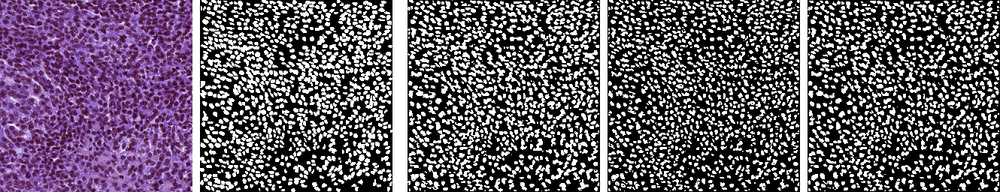

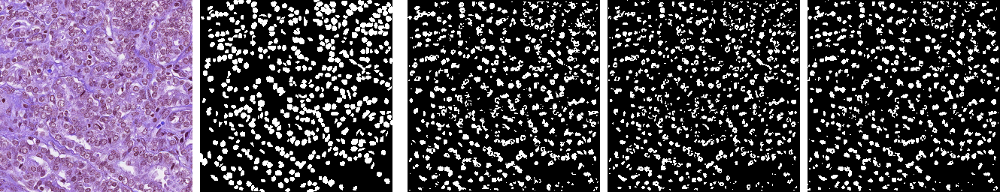

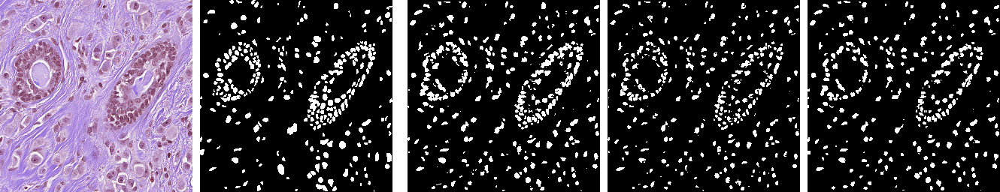

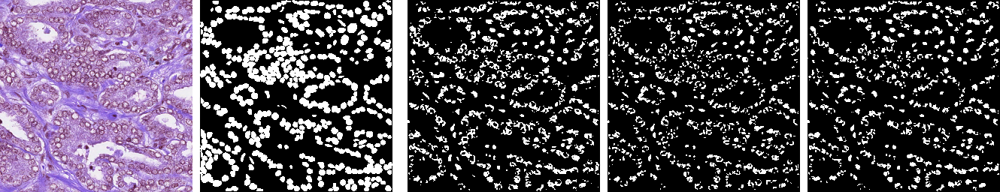

In [ ]:
print("         Input Image                    Ground Truth                  Num. of blocks=3                 Num. of blocks=4                 Num. of blocks=5         ")
for i in range(4):
  imshow3([load_img(val_input_img_paths[i], target_size=target_size),255*np.ones((IMG_HEIGHT,10,3)),ImageOps.autocontrast(load_img(val_target_img_paths[i],target_size=target_size)),255*np.ones((IMG_HEIGHT,20,3)),dmask(pred_masks[0][i]),255*np.ones((IMG_HEIGHT,10,3)),dmask(pred_masks[1][i]),255*np.ones((IMG_HEIGHT,10,3)),dmask(pred_masks[2][i])])
  cv2_imshow(np.ones((20,10))*255)


b. Number of filters per layer in the UNet architecture.

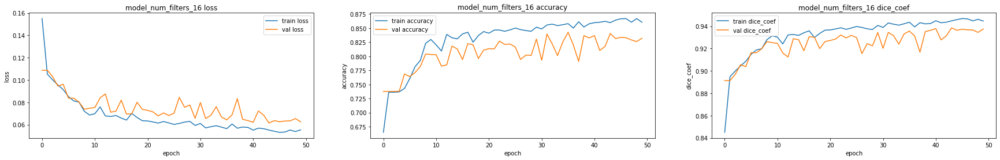

2/2 [==============================] - 0s 116ms/step


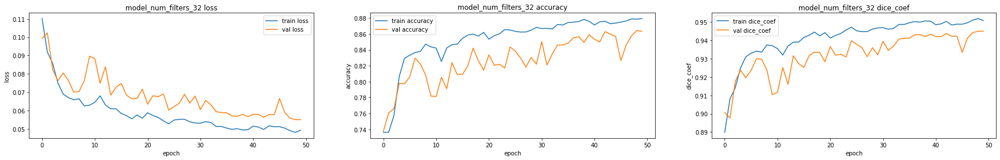

2/2 [==============================] - 0s 126ms/step


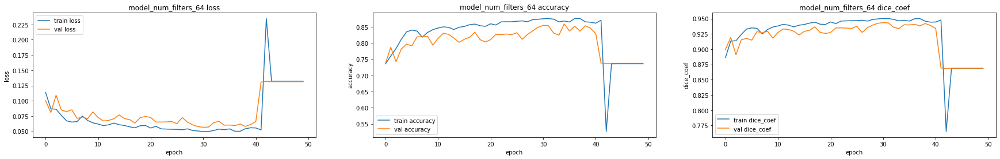

2/2 [==============================] - 0s 128ms/step


In [ ]:
num_filter_arr = [16,32,64]

pred_masks = []
for num_filt in num_filter_arr:

  model = u_net(init_filters = num_filt,num_blocks = 4,im_size = (IMG_WIDTH, IMG_HEIGHT, IMG_CHANNELS))
  model.compile(optimizer="adam", loss=dice_coef_loss, metrics=['accuracy',dice_coef])

  callbacks = [
      keras.callbacks.ModelCheckpoint("tissue_segmentation_num_filters_{}.h5".format(num_filt), save_best_only=True)
  ]

  # Train the model, doing validation at the end of each epoch.
  epochs = 50 
  history = model.fit(train_gen, epochs=epochs, validation_data=val_gen, callbacks=callbacks,verbose=0 )

  metrics = model.metrics_names
  fig, axs = plt.subplots(figsize=(30,4),nrows=1, ncols=len(metrics))

  for i,met in enumerate(metrics):
    axs[i].plot(history.history[met])
    axs[i].plot(history.history['val_'+met])
    axs[i].set_title('model_num_filters_{} {}'.format(num_filt,met))
    axs[i].set_ylabel(met)
    axs[i].set_xlabel('epoch')
    axs[i].legend(['train '+met, 'val '+met])

  plt.show()
  # Generate predictions for all images in the validation set

  val_preds = model.predict(val_gen)
  pred_masks.append(val_preds)

         Input Image                    Ground Truth                   Num. of filters=16              Num. of filters=32              Num. of filters=64         


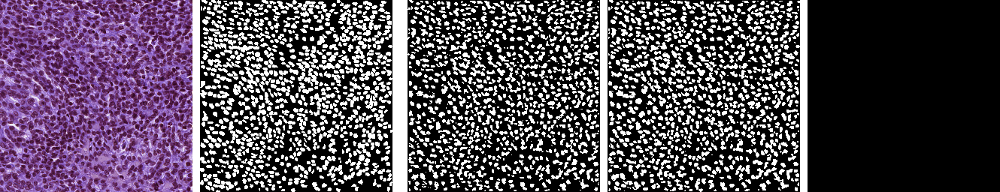

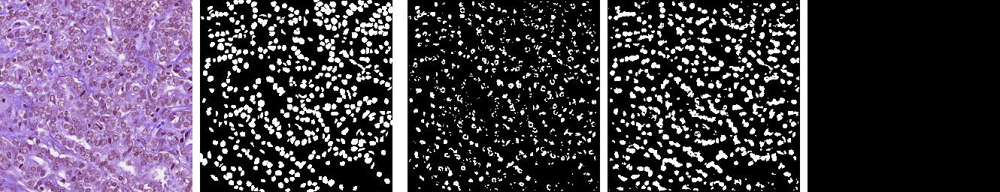

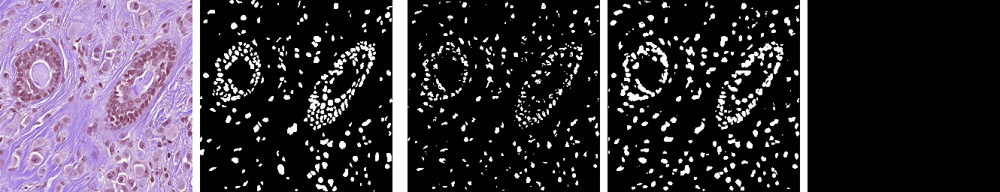

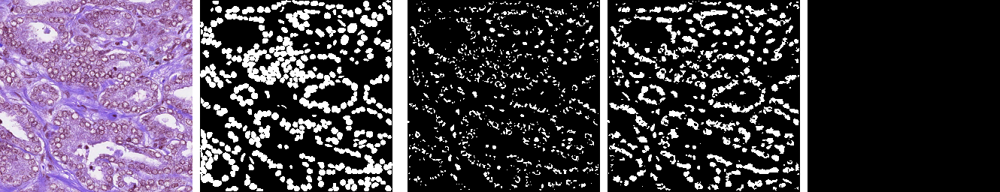

In [ ]:
print("         Input Image                    Ground Truth                   Num. of filters=16              Num. of filters=32              Num. of filters=64         ")
for i in range(4):
  imshow3([load_img(val_input_img_paths[i], target_size=target_size),255*np.ones((IMG_HEIGHT,10,3)),ImageOps.autocontrast(load_img(val_target_img_paths[i],target_size=target_size)),255*np.ones((IMG_HEIGHT,20,3)),dmask(pred_masks[0][i]),255*np.ones((IMG_HEIGHT,10,3)),dmask(pred_masks[1][i]),255*np.ones((IMG_HEIGHT,10,3)),dmask(pred_masks[2][i])])
  cv2_imshow(np.ones((20,10))*255)


c. Loss function as a combination of Dice and MS-SSIM with a trade-off parameter

In [ ]:
def MS_SSIM(y_true, y_pred):
  return tf.image.ssim_multiscale(
          y_true,
          y_pred,
          1,
          power_factors =  (0.0448, 0.2856, 0.3001, 0.2363, 0.1333),
          filter_size=7,
          filter_sigma=1.5,
          k1=0.01,
          k2=0.03)

def MS_SSIM_loss(y_true, y_pred):
  return 1-MS_SSIM(y_true, y_pred)


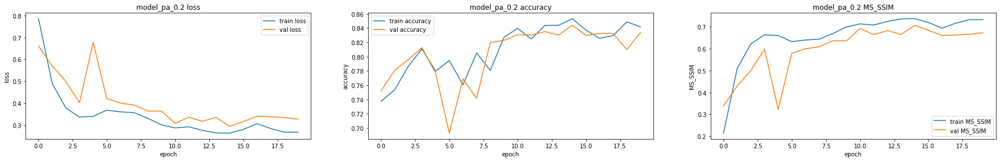

2/2 [==============================] - 0s 129ms/step


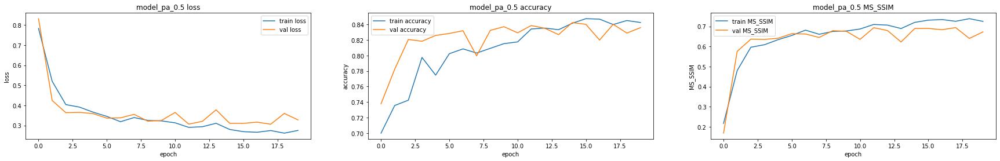

2/2 [==============================] - 0s 118ms/step


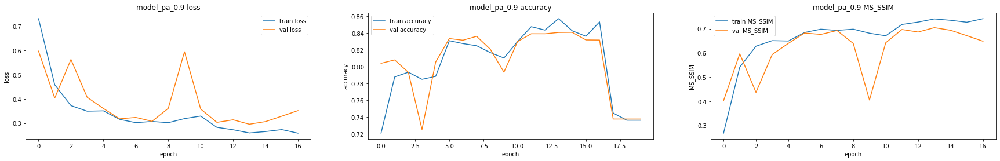

2/2 [==============================] - 0s 113ms/step


In [ ]:
pa_arr = [0.2,0.5,0.9] # tradeoff parameter

pred_masks = []
for pa in pa_arr:
  mean_hybrid_loss = lambda y_true, y_pred: (pa*MS_SSIM_loss(y_true, y_pred)+(1-pa)*dice_coef_loss(y_true, y_pred)) # pa assumed to be between 0 and 1
  # geom_hybrid_loss = lambda y_true, y_pred: (MS_SSIM_loss(y_true, y_pred)**pa)*(dice_coef_loss(y_true, y_pred)**(1-pa)) # pa assumed to be between 0 and 1

  # def mean_hybrid_loss(y_pred,y_true):
  #   return (pa*MS_SSIM_loss(y_true, y_pred)+(1-pa)*dice_coef_loss(y_true, y_pred))

  model = u_net(init_filters = 32,num_blocks = 4,im_size = (IMG_WIDTH, IMG_HEIGHT, IMG_CHANNELS))

  model.compile(optimizer="adam", loss=MS_SSIM_loss, metrics=['accuracy',MS_SSIM])

  callbacks = [
      keras.callbacks.ModelCheckpoint("tissue_segmentation_pa_{}.h5".format(pa), save_best_only=True)
  ]

  # Train the model, doing validation at the end of each epoch.
  epochs = 20 
  history = model.fit(train_gen, epochs=epochs, validation_data=val_gen, callbacks=callbacks,verbose=0)

  metrics = model.metrics_names
  fig, axs = plt.subplots(figsize=(30,4),nrows=1, ncols=len(metrics))

  for i,met in enumerate(metrics):
    axs[i].plot(history.history[met])
    axs[i].plot(history.history['val_'+met])
    axs[i].set_title('model_pa_{} {}'.format(pa,met))
    axs[i].set_ylabel(met)
    axs[i].set_xlabel('epoch')
    axs[i].legend(['train '+met, 'val '+met])

  plt.show()

  # Generate predictions for all images in the validation set
  val_preds = model.predict(val_gen)
  pred_masks.append(val_preds)

         Input Image                    Ground Truth                  Tradeoff Factor=0.2              Tradeoff Factor=0.5               Tradeoff Factor=0.9         


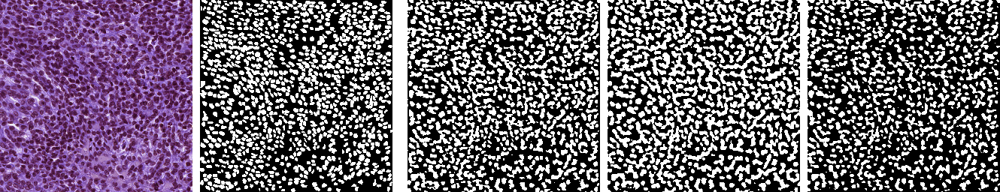

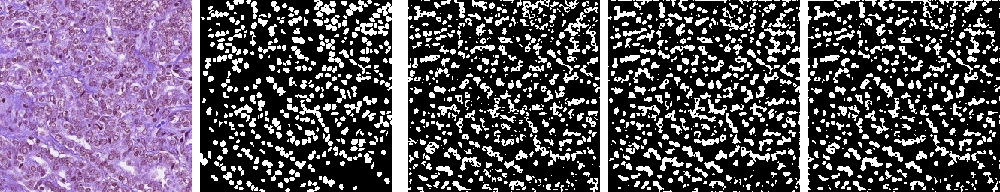

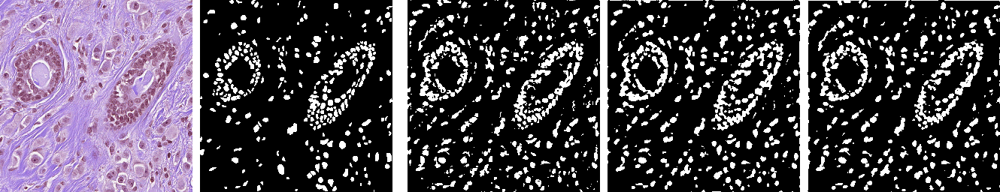

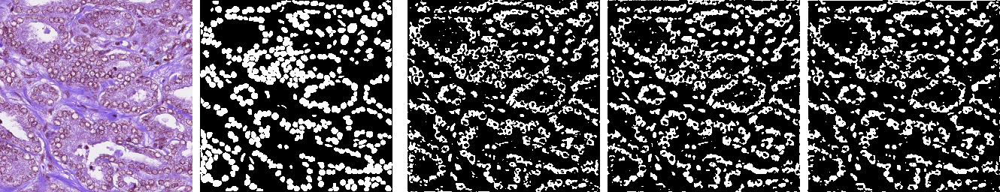

In [ ]:
print("         Input Image                    Ground Truth                  Tradeoff Factor=0.2              Tradeoff Factor=0.5               Tradeoff Factor=0.9         ")
for i in range(4):
  imshow3([load_img(val_input_img_paths[i], target_size=target_size),255*np.ones((IMG_HEIGHT,10,3)),ImageOps.autocontrast(load_img(val_target_img_paths[i],target_size=target_size)),255*np.ones((IMG_HEIGHT,20,3)),dmask(pred_masks[0][i]),255*np.ones((IMG_HEIGHT,10,3)),dmask(pred_masks[1][i]),255*np.ones((IMG_HEIGHT,10,3)),dmask(pred_masks[2][i])])
  cv2_imshow(np.ones((20,10))*255)


## **Problem 6:**

#### Use watershed segmentation on the probability map produced by the UNet to segment individual nuclei, and show results on test images with touching or overlapping nuclei. Experiment with various parameters of watershed algorithms to try to improve the results.

In [ ]:
K.clear_session()
model = u_net(init_filters = 32,num_blocks = 4,im_size = (IMG_WIDTH, IMG_HEIGHT, IMG_CHANNELS))

model.compile(optimizer="adam", loss=dice_coef_loss, metrics=['accuracy',dice_coef])

callbacks = [
    keras.callbacks.ModelCheckpoint("tissue_segmentation_final.h5", save_best_only=True)
]

# Train the model, doing validation at the end of each epoch.
epochs = 50 
history = model.fit(train_gen, epochs=epochs, validation_data=val_gen, callbacks=callbacks )

# Generate predictions for all images in the validation set
val_preds = model.predict(val_gen)

Epoch 1/50
13/13 [==============================] - 4s 226ms/step - loss: 0.1316 - accuracy: 0.7211 - dice_coef: 0.8684 - val_loss: 0.1057 - val_accuracy: 0.7377 - val_dice_coef: 0.8943
Epoch 2/50
13/13 [==============================] - 2s 185ms/step - loss: 0.0996 - accuracy: 0.7362 - dice_coef: 0.9004 - val_loss: 0.0967 - val_accuracy: 0.7377 - val_dice_coef: 0.9033
Epoch 3/50
13/13 [==============================] - 2s 183ms/step - loss: 0.0892 - accuracy: 0.7377 - dice_coef: 0.9108 - val_loss: 0.0864 - val_accuracy: 0.7507 - val_dice_coef: 0.9136
Epoch 4/50
13/13 [==============================] - 2s 192ms/step - loss: 0.0824 - accuracy: 0.7750 - dice_coef: 0.9176 - val_loss: 0.0779 - val_accuracy: 0.7886 - val_dice_coef: 0.9221
Epoch 5/50
13/13 [==============================] - 2s 162ms/step - loss: 0.0741 - accuracy: 0.8185 - dice_coef: 0.9259 - val_loss: 0.0824 - val_accuracy: 0.7898 - val_dice_coef: 0.9176
Epoch 6/50
13/13 [==============================] - 2s 185ms/step - lo

In [ ]:
from skimage.feature import peak_local_max
from skimage.segmentation import watershed
from scipy import ndimage

Raw Outputs


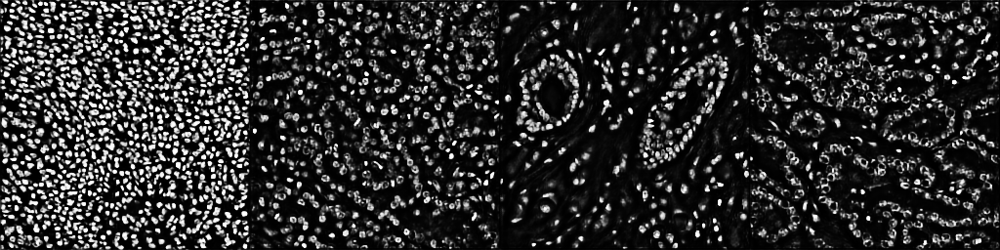

Watershed outputs


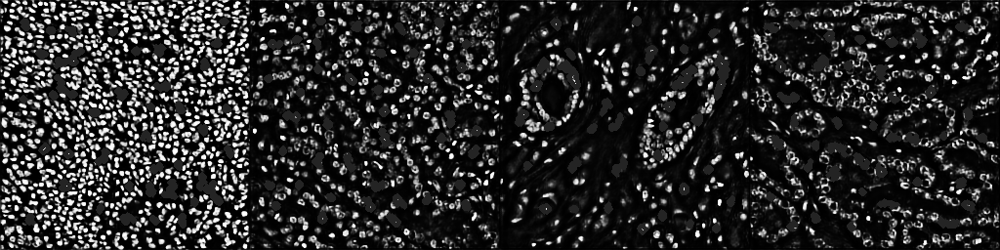

In [ ]:
pred_uint8 = (val_preds*255).astype("uint8") 

print("Raw Outputs")
imshow3(pred_uint8)
watershed_o = []

for i in range(4):
  image = pred_uint8[i]

  gray = image
  thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]

  # Compute Euclidean distance from every binary pixel
  # to the nearest zero pixel then find peaks
  distance_map = ndimage.distance_transform_edt(thresh)
  local_max = peak_local_max(distance_map, indices=False, min_distance=20, labels=thresh)

  # Perform connected component analysis then apply Watershed
  markers = ndimage.label(local_max, structure=np.ones((3, 3)))[0]
  labels = watershed(-distance_map, markers, mask=thresh)

  # Iterate through unique labels
  total_area = 0
  for label in np.unique(labels):
      if label == 0:
          continue

      # Create a mask
      mask = np.zeros(gray.shape, dtype="uint8")
      mask[labels == label] = 255

      # Find contours and determine contour area
      cnts = cv2.findContours(mask.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
      cnts = cnts[0] if len(cnts) == 2 else cnts[1]
      c = max(cnts, key=cv2.contourArea)
      area = cv2.contourArea(c)
      total_area += area
      cv2.drawContours(image, [c], -1, (36,255,12), 4)

  watershed_o.append(image)

print("Watershed outputs")

imshow3([watershed_o[0],watershed_o[1],watershed_o[2],watershed_o[3]])

# References

1. [Diceloss](https://stackoverflow.com/questions/70514123/trying-to-use-dice-loss-with-unet)

2. [how-to-ignore-hidden-files-using-os-listdir](https://stackoverflow.com/questions/7099290/how-to-ignore-hidden-files-using-os-listdir)

3. [simple-cell-segmentation-with-keras-and-u-net](https://www.kaggle.com/code/vbookshelf/simple-cell-segmentation-with-keras-and-u-net/notebook)

4. [model_plotting_utils](https://keras.io/api/utils/model_plotting_utils/)

5. [The Model API](https://keras.io/api/models/model/)

6. [Oxford pets image segmentation](https://keras.io/examples/vision/oxford_pets_image_segmentation/)

7. [U-Net: Convolutional Networks for Biomedical Image Segmentation
](https://arxiv.org/abs/1505.04597v1)

8. [Watershed segmentation in opencv python](https://stackoverflow.com/questions/57813137/how-to-use-watershed-segmentation-in-opencv-python)